<a href="https://colab.research.google.com/github/shay-dan/DS_workshop_OpenUIL/blob/main/Prediction_Object_Detection_YOLOv8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


##Yolov8:


Now we will train a YOLOv8 model on our dataset. Information about the model can be found on chapter 6 - presentation of the models.

We begin with imports and installs:

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!pip install ultralytics
!pip install --upgrade ultralytics

from IPython import display
# display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.1.11 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.3/107.7 GB disk)


In [ ]:
from ultralytics import YOLO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display, Image

Now, we use the same augmented dataset as we have for detectron2, so first we must change the input format of the annotations from COCO to YOLO, i.e the bboxes annotations.

YOLO annoations are a .txt file for each image, in the form of [class, x_center, y_center, width, height] where xywh format is normalized (from 0 to 1).

We will use again the modules from pylabel.

In [ ]:
#this func is to make train/val/test all have same cls:idx
def update_jsons(cls_to_id_new, to_update_path_to_json):

  cls_to_id_old = get_cls_to_id("/content/drive/MyDrive/dataset_augmented/val/Val.json")

  with open(to_update_path_to_json) as f:
    data = json.load(f)

  out_file = open(to_update_path_to_json, "w")

  for i, item in enumerate(data["categories"]):
    item["id"] = list(cls_to_id_new.values())[i]
    item["name"] = list(cls_to_id_new.keys())[i]
    if item["name"] =='coin':
      coin_id = item["id"]
    if item["name"] =='fired_dough_twist':
      fdt_id = item["id"]

  for item in data["images"]:
    idx = item["id"]
    tmp = item["file_name"].split("0")[0]
    r = tmp.split("_")[-1]
    if tmp == "mix":
      for ann in data["annotations"]:
        if ann["image_id"] == idx:
          for key,value in cls_to_id_old.items():
            if ann["category_id"] == coin_id:
              continue
            elif ann["category_id"] == value:
              for k,v in cls_to_id_new.items():
                if key == k:
                  ann["category_id"] = list(cls_to_id.values())[v]
                  break
              break
    if r == "mix":
      for ann in data["annotations"]:
        if ann["image_id"] == idx:
          for key,value in cls_to_id_old.items():
            if ann["category_id"] == coin_id:
              continue
            elif ann["category_id"] == value:
              for k,v in cls_to_id_new.items():
                if key == k:
                  ann["category_id"] = list(cls_to_id.values())[v]
                  break
              break

    else:
      if r == 'twist':
        for ann in data["annotations"]:
          if ann["image_id"] == idx:
            if ann["category_id"] != coin_id:
              ann["category_id"] = fdt_id
      else:
        for k,v in cls_to_id_new.items():
          if r == k:
            for ann in data["annotations"]:
              if ann["image_id"] == idx:
                if ann["category_id"] != coin_id:
                  ann["category_id"] = v


  json.dump(data, out_file, indent = 4)
  out_file.close()

def get_cls_to_id(path_to_json):

  key = []
  value = []

  with open(path_to_json) as f:
    data = json.load(f)

  for i, item in enumerate(data["categories"]):
    value.append(item["id"])
    key.append(item["name"])

  cls_to_id = dict(zip(key,value))

  return cls_to_id

cls_to_id = get_cls_to_id("/content/drive/MyDrive/dataset_augmented/train/Updated_Train.json")
update_jsons(cls_to_id,"/content/drive/MyDrive/dataset_augmented/val/Updated_Val.json")


In [ ]:
def coco2yolo(path_to_images_coco):

  root = '/content/dataset_yolo'
  os.makedirs(root, exist_ok=True)

  path_to_annotations_yolo = []
  path_to_images_yolo = []
  ins_array = ['train', 'val','test']
  json_array = ['Updated_Train.json', 'Updated_Val.json','Test.json']
  for i,ins in enumerate(ins_array):
    path_to_annotations_yolo.append(path_to_images_coco + '/' + ins + '/'+ json_array[i])
    path_to_images_yolo.append(path_to_images_coco + '/' + ins)
  dataset_train = importer.ImportCoco(path_to_annotations_yolo[0], path_to_images=path_to_images_yolo[0], name="Train_coco")
  dataset_val = importer.ImportCoco(path_to_annotations_yolo[1], path_to_images=path_to_images_yolo[1], name="Val_coco")
  dataset_test = importer.ImportCoco(path_to_annotations_yolo[2], path_to_images=path_to_images_yolo[2], name="Test_coco")

  dataset_train.export.ExportToYoloV5(str(root + '/train/labels'))
  dataset_val.export.ExportToYoloV5(str(root + '/val/labels'))
  dataset_test.export.ExportToYoloV5(str(root + '/test/labels'))
  return dataset_train,dataset_val,dataset_test

dataset_train,dataset_val,dataset_test = coco2yolo("/content/drive/MyDrive/dataset_augmented")

Exporting YOLO files...: 100%|██████████| 200/200 [00:00<00:00, 492.81it/s]


We uploaded the format to disk (colab environment) from our drive, now we will copy our images from our drive to the disk as well. This is done to speed the training, since pulling from drive is much slower.

In [ ]:
path  = "/content/drive/MyDrive/dataset_augmented/"
ins_array = ['train', 'val','test']
for ins in ins_array:
  if not os.path.exists("/content/dataset_yolo/" + ins + "/images/"):
    os.mkdir("/content/dataset_yolo/" + ins + "/images/")
  for file in os.listdir(path + ins):
    if file[-3:] == "JPG":
      shutil.copyfile(path +ins + "/" + file, "/content/dataset_yolo/" + ins + "/images/" + file)

shutil.copyfile("/content/dataset_yolo/train/dataset.yaml", "/content/dataset_yolo/dataset.yaml")
os.remove("/content/dataset_yolo/train/dataset.yaml")
os.remove("/content/dataset_yolo/val/dataset.yaml")
os.remove("/content/dataset_yolo/test/dataset.yaml")

In [ ]:
print(len(os.listdir("/content/dataset_yolo/train/labels")))
print(len(os.listdir("/content/dataset_yolo/train/images")))
print(len(os.listdir("/content/dataset_yolo/val/labels")))
print(len(os.listdir("/content/dataset_yolo/val/images")))
print(len(os.listdir("/content/dataset_yolo/test/labels")))
print(len(os.listdir("/content/dataset_yolo/test/images")))

5000
5000
1100
1100
200
200


Now, we need to update the paths in the yaml file from which YOLO takes it's config.

In [ ]:
import yaml

with open('/content/dataset_yolo/dataset.yaml', 'r') as f:
    data = yaml.safe_load(f)

data["train"] = "/content/dataset_yolo/train/images"
data["val"] = "/content/dataset_yolo/val/images"
data["test"] = "/content/dataset_yolo/test/images"

with open('/content/dataset_yolo/dataset.yaml', 'w') as f:
    yaml.dump(data, f, default_flow_style=False)
%cat /content/dataset_yolo/dataset.yaml

names:
- doughnut
- coin
- plum
- orange
- mango
- lemon
- fired_dough_twist
- bread
- mooncake
- pear
- litchi
- bun
- apple
- banana
- egg
- qiwi
- peach
- sachima
- tomato
- grape
nc: 20
path: ..
test: /content/dataset_yolo/test/images
train: /content/dataset_yolo/train/images
val: /content/dataset_yolo/val/images


Now we are ready to start training!

First, we will use the pretraind model 'yolov8m' for object detection. It was trained on the COCO2017 dataset. We want to perform transfer learning from it, to train our model on our dataset.

Ultralytics suggests using 300 epochs, but it will take us about 15 hours to complete, and crashes colab due to lack of RAM. So, we start by training for 100 epochs, and will increase our epochs in 25 epoch intervals if the results aren't good enough, while continuing to train from our last comlpleted training.

* If we continue our training we must start a new train instance, since  the number of epochs is a fixed parameted of the specific training session, so it can't be modified after training has finished. If we choose to continue training, we will start a new train instance but with the weights we already trained, and upload it to a new model-train with new number of epochs, i.e,  we will recursivelly call our best trained weights on a new train instance.

First train for 100 epochs - we start from the pretrained model by ultralytics.

In [ ]:
import datetime
start = datetime.datetime.now()

model = YOLO('yolov8m.pt')  # pretrained model
results = model.train(data='/content/dataset_yolo/dataset.yaml',
                      project="/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results",
                      name="100_epochs-",
                      epochs=100,
                      patience=25,
                      imgsz=640)

end = datetime.datetime.now()
print("Total execution time of YOLOv8 with 100 epochs is: ", end-start)

100%|██████████| 49.7M/49.7M [00:00<00:00, 265MB/s]


Ultralytics YOLOv8.1.8 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/dataset_yolo/dataset.yaml, epochs=100, time=None, patience=25, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results, name=100_epochs-3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False,

train: Scanning /content/dataset_yolo/train/labels.cache... 5000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5000/5000 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/dataset_yolo/val/labels.cache... 1100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1100/1100 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-3
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      7.15G     0.8119      3.629      1.107         70        640:   8%|▊         | 25/313 [00:14<02:47,  1.72it/s]


KeyboardInterrupt: 

Our training wasn't completed, we continue from our best epoch until we finish 100 epochs:

In [ ]:
import datetime
start = datetime.datetime.now()

model = YOLO('/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt')  # load a pretrained model
results = model.train(data='/content/dataset_yolo/dataset.yaml',
                      project="/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results",
                      name="100_epochs-",
                      epochs=100,
                      patience=25,
                      resume= True,
                      imgsz=640)

end = datetime.datetime.now()
print("Total execution time of YOLOv8 with 100 epochs is: ", end-start)

Ultralytics YOLOv8.1.8 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt, data=/content/dataset_yolo/dataset.yaml, epochs=100, time=None, patience=25, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results, name=100_epochs-, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=Non

train: Scanning /content/dataset_yolo/train/labels.cache... 5000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5000/5000 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset_yolo/val/labels.cache... 1100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1100/1100 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Resuming training from /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt from epoch 49 to 100 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      9.07G      0.418     0.2249      0.882         29        640: 100%|██████████| 313/313 [02:44<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.19it/s]

                   all       1100       2240      0.919      0.916      0.901      0.839



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      9.63G     0.4187     0.2223     0.8806         23        640: 100%|██████████| 313/313 [02:43<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.39it/s]


                   all       1100       2240      0.922      0.915      0.898      0.841

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      9.65G     0.4135     0.2186     0.8794         35        640: 100%|██████████| 313/313 [02:44<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.41it/s]


                   all       1100       2240       0.92      0.919      0.902      0.842

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      9.66G     0.4153     0.2221     0.8804         26        640: 100%|██████████| 313/313 [02:44<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.34it/s]

                   all       1100       2240      0.923       0.92      0.889      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      9.67G     0.4144     0.2219     0.8787         32        640: 100%|██████████| 313/313 [02:43<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.21it/s]


                   all       1100       2240      0.918      0.921      0.888      0.824

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      9.63G     0.4091     0.2172     0.8798         28        640: 100%|██████████| 313/313 [02:44<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:17<00:00,  2.04it/s]


                   all       1100       2240      0.921      0.918      0.898      0.837

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      9.65G     0.4053     0.2143     0.8766         33        640: 100%|██████████| 313/313 [02:44<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.24it/s]


                   all       1100       2240      0.924      0.921      0.893      0.833

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      9.67G     0.4034     0.2141     0.8735         21        640: 100%|██████████| 313/313 [02:44<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.19it/s]

                   all       1100       2240       0.92       0.92      0.899      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      9.66G      0.402     0.2121     0.8752         25        640: 100%|██████████| 313/313 [02:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.35it/s]


                   all       1100       2240      0.922      0.919      0.889      0.829

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      9.62G     0.3971     0.2094     0.8727         25        640: 100%|██████████| 313/313 [02:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:16<00:00,  2.14it/s]


                   all       1100       2240      0.923      0.916      0.892      0.833

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      9.63G     0.3929     0.2078     0.8716         33        640: 100%|██████████| 313/313 [02:44<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.36it/s]


                   all       1100       2240      0.924       0.92      0.889      0.831

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      9.66G     0.3941     0.2099     0.8748         26        640: 100%|██████████| 313/313 [02:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.36it/s]

                   all       1100       2240      0.923      0.919      0.886       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      9.64G     0.3909     0.2063     0.8704         19        640: 100%|██████████| 313/313 [02:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.37it/s]


                   all       1100       2240      0.925      0.921       0.89      0.831

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      9.64G     0.3904      0.206     0.8711         21        640: 100%|██████████| 313/313 [02:44<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.32it/s]


                   all       1100       2240      0.922      0.921      0.893      0.832

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      9.63G      0.385     0.2032     0.8714         29        640: 100%|██████████| 313/313 [02:44<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:16<00:00,  2.11it/s]


                   all       1100       2240      0.924       0.92      0.894      0.836

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      9.67G     0.3796     0.1983     0.8673         26        640: 100%|██████████| 313/313 [02:44<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.19it/s]

                   all       1100       2240      0.925      0.922      0.897      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      9.68G     0.3785     0.1974     0.8677         34        640: 100%|██████████| 313/313 [02:43<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.22it/s]

                   all       1100       2240      0.922      0.919      0.892      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      9.62G     0.3739     0.1965     0.8644         23        640: 100%|██████████| 313/313 [02:42<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.24it/s]


                   all       1100       2240      0.924      0.923      0.888      0.829

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      9.65G     0.3783     0.1982     0.8665         25        640: 100%|██████████| 313/313 [02:43<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.22it/s]

                   all       1100       2240      0.924      0.921       0.89      0.832



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      9.67G      0.374     0.1962     0.8642         28        640: 100%|██████████| 313/313 [02:42<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.27it/s]

                   all       1100       2240      0.924      0.919      0.889       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      9.64G     0.3688     0.1939     0.8626         22        640: 100%|██████████| 313/313 [02:44<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.45it/s]


                   all       1100       2240      0.924       0.92      0.893      0.834

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      9.63G     0.3651     0.1909      0.861         29        640: 100%|██████████| 313/313 [02:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:17<00:00,  2.01it/s]

                   all       1100       2240      0.925      0.922      0.896       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      9.64G      0.362     0.1881     0.8611         28        640: 100%|██████████| 313/313 [02:43<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:14<00:00,  2.42it/s]


                   all       1100       2240      0.925      0.922      0.894      0.838

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      9.66G     0.3643     0.1919      0.858         55        640:   7%|▋         | 21/313 [00:11<02:26,  1.99it/s]

In [ ]:
import datetime
start = datetime.datetime.now()

model = YOLO('/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/last.pt')  # load a pretrained model
results = model.train(data='/content/dataset_yolo/dataset.yaml',
                      project="/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results",
                      name="100_epochs-",
                      epochs=100,
                      patience=25,
                      resume= True,
                      imgsz=640)

end = datetime.datetime.now()
print("Total execution time of YOLOv8 with 100 epochs is: ", end-start)

Ultralytics YOLOv8.1.8 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/last.pt, data=/content/dataset_yolo/dataset.yaml, epochs=100, time=None, patience=25, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results, name=100_epochs-, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=Non

100%|██████████| 755k/755k [00:00<00:00, 21.5MB/s]


TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultraly

100%|██████████| 6.23M/6.23M [00:00<00:00, 75.7MB/s]


AMP: checks passed ✅


train: Scanning /content/dataset_yolo/train/labels... 5000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5000/5000 [00:03<00:00, 1341.54it/s]


train: New cache created: /content/dataset_yolo/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/dataset_yolo/val/labels... 1100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1100/1100 [00:01<00:00, 672.69it/s]


val: New cache created: /content/dataset_yolo/val/labels.cache
Plotting labels to /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Resuming training from /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/last.pt from epoch 72 to 100 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      7.07G     0.3499     0.1841     0.8578         29        640: 100%|██████████| 313/313 [02:54<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:17<00:00,  1.97it/s]

                   all       1100       2240      0.924       0.92      0.895      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      7.08G     0.3498     0.1828     0.8559         23        640: 100%|██████████| 313/313 [02:48<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.20it/s]

                   all       1100       2240      0.925      0.921      0.888      0.832



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      7.09G     0.3467     0.1813     0.8563         35        640: 100%|██████████| 313/313 [02:47<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:16<00:00,  2.14it/s]


                   all       1100       2240      0.925      0.922      0.893      0.835

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100       7.1G     0.3465     0.1817      0.856         26        640: 100%|██████████| 313/313 [02:47<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:16<00:00,  2.09it/s]

                   all       1100       2240      0.923      0.918      0.894      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      7.12G     0.3457     0.1794     0.8543         32        640: 100%|██████████| 313/313 [02:49<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.19it/s]

                   all       1100       2240      0.922      0.918      0.892      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      7.07G     0.3429      0.178      0.856         28        640: 100%|██████████| 313/313 [02:49<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.29it/s]

                   all       1100       2240      0.921      0.917      0.901      0.844



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.08G     0.3391     0.1767     0.8526         33        640: 100%|██████████| 313/313 [02:48<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.28it/s]


                   all       1100       2240      0.924      0.916      0.892      0.834

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      7.12G     0.3364     0.1755     0.8495         21        640: 100%|██████████| 313/313 [02:50<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.26it/s]

                   all       1100       2240      0.923       0.92      0.891      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      7.09G     0.3328     0.1715     0.8506         25        640: 100%|██████████| 313/313 [02:48<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.21it/s]


                   all       1100       2240      0.925      0.921       0.89      0.833

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      7.07G     0.3307     0.1704      0.849         25        640: 100%|██████████| 313/313 [02:49<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:18<00:00,  1.93it/s]

                   all       1100       2240      0.924      0.921      0.887      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      7.09G     0.3285     0.1697     0.8491         33        640: 100%|██████████| 313/313 [02:47<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.19it/s]

                   all       1100       2240      0.923      0.918      0.892      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      7.11G     0.3284     0.1698     0.8512         26        640: 100%|██████████| 313/313 [02:49<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.28it/s]

                   all       1100       2240      0.923      0.919      0.891      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100       7.1G     0.3248     0.1677     0.8484         19        640: 100%|██████████| 313/313 [02:48<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.20it/s]

                   all       1100       2240      0.921      0.918      0.898       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      7.07G     0.3262     0.1673     0.8484         21        640: 100%|██████████| 313/313 [02:51<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.29it/s]


                   all       1100       2240      0.922      0.918      0.889      0.832

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      7.08G     0.3206     0.1656     0.8486         29        640: 100%|██████████| 313/313 [02:48<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.22it/s]

                   all       1100       2240      0.923       0.92      0.891      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100       7.1G     0.3154     0.1631     0.8448         26        640: 100%|██████████| 313/313 [02:49<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:16<00:00,  2.18it/s]


                   all       1100       2240      0.923       0.92      0.894      0.837

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      7.11G      0.315     0.1621     0.8451         34        640: 100%|██████████| 313/313 [02:47<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.21it/s]

                   all       1100       2240      0.923       0.92      0.895      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      7.07G     0.3104     0.1598     0.8428         23        640: 100%|██████████| 313/313 [02:50<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.28it/s]


                   all       1100       2240      0.924       0.92      0.893      0.839

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      7.08G     0.3131      0.162     0.8438         25        640: 100%|██████████| 313/313 [02:49<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.27it/s]

                   all       1100       2240      0.924       0.92      0.891      0.835


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      7.11G     0.3094     0.1492     0.8348         17        640: 100%|██████████| 313/313 [02:49<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.28it/s]

                   all       1100       2240      0.923      0.919       0.89      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      7.11G     0.3016     0.1477     0.8345         15        640: 100%|██████████| 313/313 [02:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.28it/s]


                   all       1100       2240      0.923      0.919      0.889      0.833

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      7.07G     0.2989     0.1449     0.8293         16        640: 100%|██████████| 313/313 [02:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:18<00:00,  1.94it/s]

                   all       1100       2240      0.925      0.919      0.888       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      7.09G     0.2956     0.1432       0.83         16        640: 100%|██████████| 313/313 [02:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:16<00:00,  2.15it/s]

                   all       1100       2240      0.925      0.921      0.888       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      7.11G      0.296     0.1427     0.8303         16        640: 100%|██████████| 313/313 [02:47<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.20it/s]

                   all       1100       2240      0.925      0.921      0.888      0.829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      7.11G     0.2932     0.1406     0.8299         16        640: 100%|██████████| 313/313 [02:48<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.26it/s]


                   all       1100       2240      0.924       0.92      0.888      0.831

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      7.07G     0.2899     0.1394     0.8285         16        640: 100%|██████████| 313/313 [02:47<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:15<00:00,  2.27it/s]

                   all       1100       2240      0.923      0.921      0.889      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      7.08G     0.2873     0.1386     0.8271         16        640: 100%|██████████| 313/313 [02:48<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:16<00:00,  2.15it/s]


                   all       1100       2240      0.925       0.92       0.89      0.833

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      7.09G      0.288      0.138     0.8289         15        640: 100%|██████████| 313/313 [02:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:16<00:00,  2.09it/s]

                   all       1100       2240      0.925      0.921       0.89      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100       7.1G     0.2867     0.1371     0.8277         16        640: 100%|██████████| 313/313 [02:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:17<00:00,  2.05it/s]

                   all       1100       2240      0.925       0.92       0.89      0.834



29 epochs completed in 1.525 hours.
Optimizer stripped from /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/last.pt, 52.1MB
Optimizer stripped from /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt, 52.1MB

Validating /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt...
Ultralytics YOLOv8.1.8 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25851340 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:20<00:00,  1.73it/s]


                   all       1100       2240      0.919      0.914      0.906      0.845
              doughnut       1100         72      0.996      0.764      0.861      0.823
                  coin       1100       1085      0.999          1      0.995      0.869
                  plum       1100         75      0.998      0.733      0.852      0.794
                orange       1100         80      0.711      0.675      0.713      0.696
                 mango       1100         55      0.684      0.985      0.828      0.771
                 lemon       1100         55        0.9          1      0.969      0.909
     fired_dough_twist       1100         55      0.997          1      0.995       0.91
                 bread       1100         55      0.999          1      0.995      0.931
              mooncake       1100         77      0.998      0.714      0.856      0.804
                  pear       1100         59      0.773      0.932      0.815      0.774
                litch

Finaly we are done, since the model stopped several times we can't know how long the training took, but 28 epochs took us 92 minutes, so in total our training took about 5-6 hours.

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-

<IPython.core.display.Javascript object>

YOLO saves all training curves, metrics, and other results as images in our directory. let's see some of them:

We start with a confusion matrix, with number of instances:

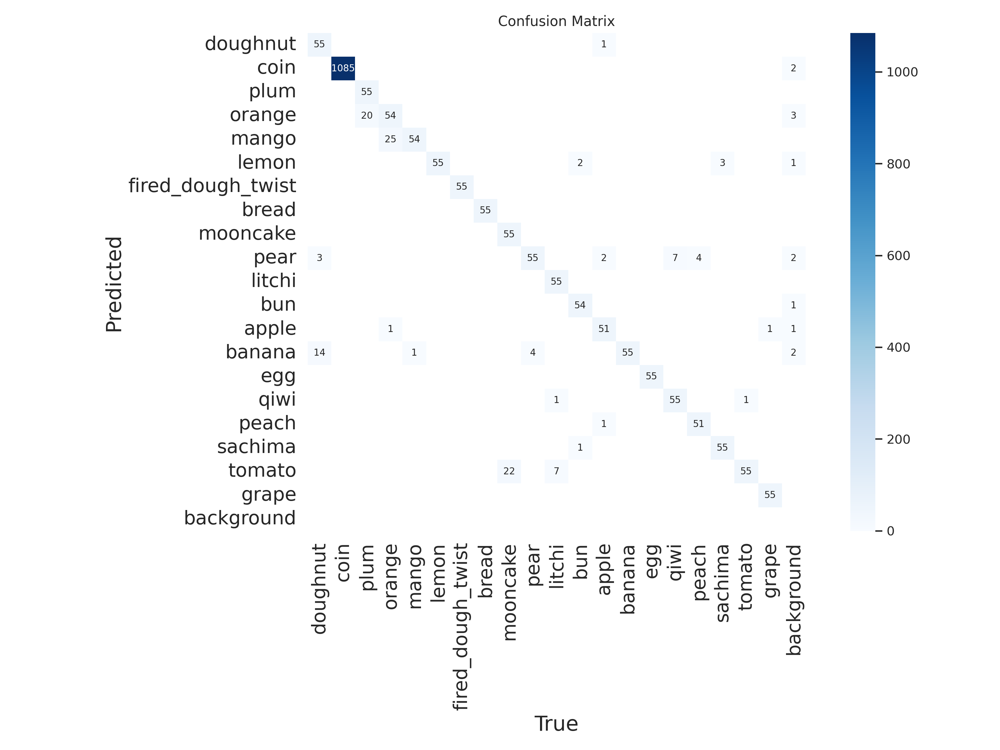

In [ ]:
Image(filename='/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/confusion_matrix.png', width=1200)

Now a normalized confusion matrix:

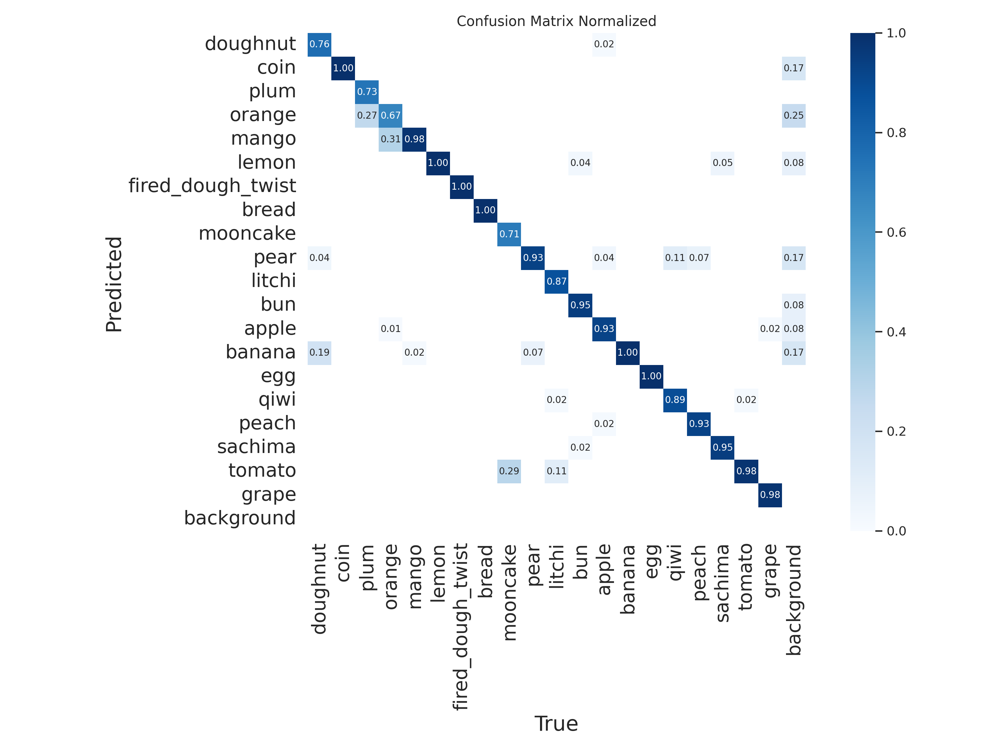

In [ ]:
Image(filename='/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/confusion_matrix_normalized.png', width=1200)

Now for the training curves:

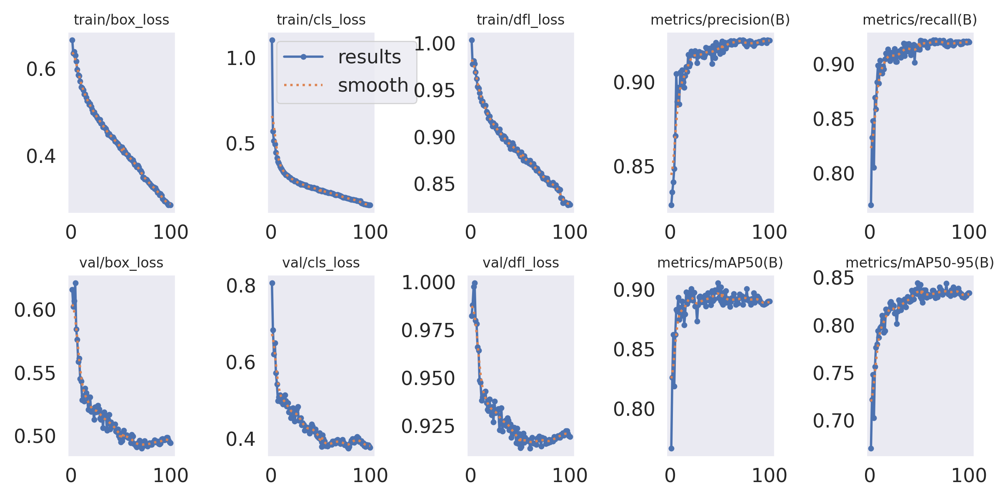

In [ ]:
Image(filename='/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/results.png', width=1800)

Based on the plots above, we can see that the training curves haven't flattened yet, but the validation curves appears to begin overfitting, so we will stop the training at 100 epochs.

Now let's run validation alone:

In [ ]:
model = YOLO('/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt')  # load our custom model
metrics = model.val(data="/content/dataset_yolo/dataset.yaml",
                      project="/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results",
                      name="100_epochs-val",
                      save_json = True, conf = 0.5, plots = True)

Ultralytics YOLOv8.1.11 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 218 layers, 25851340 parameters, 0 gradients, 78.7 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 17.0MB/s]
val: Scanning /content/dataset_yolo/val/labels... 1100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1100/1100 [00:02<00:00, 373.54it/s]


val: New cache created: /content/dataset_yolo/val/labels.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  20%|██        | 14/69 [07:11<28:17, 30.86s/it]


KeyboardInterrupt: 

Let's see some of the curves:

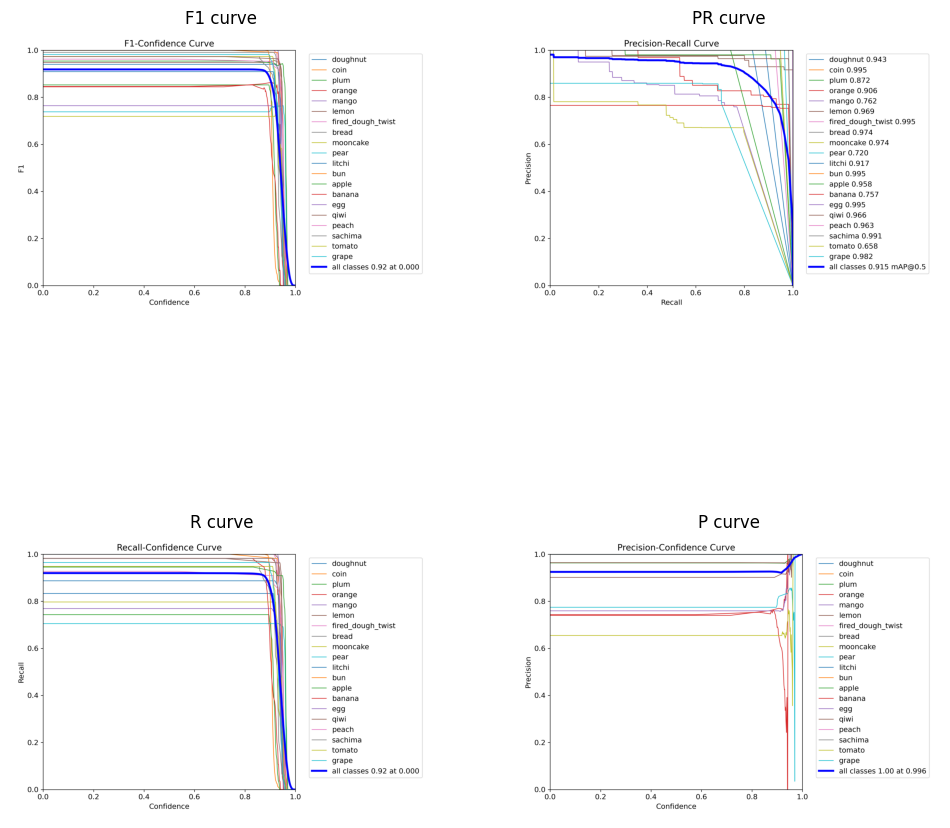

In [ ]:
fig, axes = plt.subplots(figsize=(12,12), ncols=2, nrows=2)
image = cv2.imread("/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-val/F1_curve.png")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
axes[0,0].imshow(image)
axes[0,0].title.set_text('F1 curve')
axes[0,0].axis('off')
image = cv2.imread("/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-val/PR_curve.png")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
axes[0,1].imshow(image)
axes[0,1].title.set_text('PR curve')
axes[0,1].axis('off')
image = cv2.imread("/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-val/R_curve.png")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
axes[1,0].imshow(image)
axes[1,0].title.set_text('R curve')
axes[1,0].axis('off')
image = cv2.imread("/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-val/P_curve.png")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
axes[1,1].imshow(image)
axes[1,1].title.set_text('P curve')
axes[1,1].axis('off')
plt.show()

Now for the mAP's of the validation set:

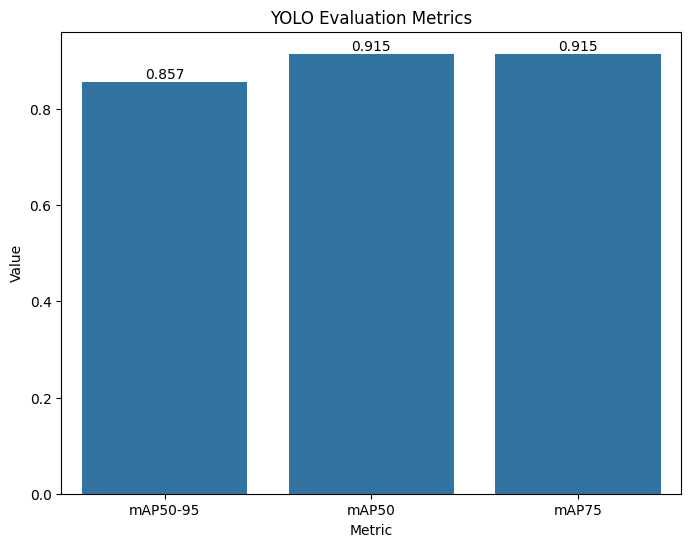

In [ ]:
ax = sns.barplot(x=['mAP50-95', 'mAP50', 'mAP75'], y=[metrics.box.map, metrics.box.map50, metrics.box.map75])

ax.set_title('YOLO Evaluation Metrics')
ax.set_xlabel('Metric')
ax.set_ylabel('Value')

fig = plt.gcf()
fig.set_size_inches(8, 6)

for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')

plt.show()

<ipython-input-131-d6f4eea00a51>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


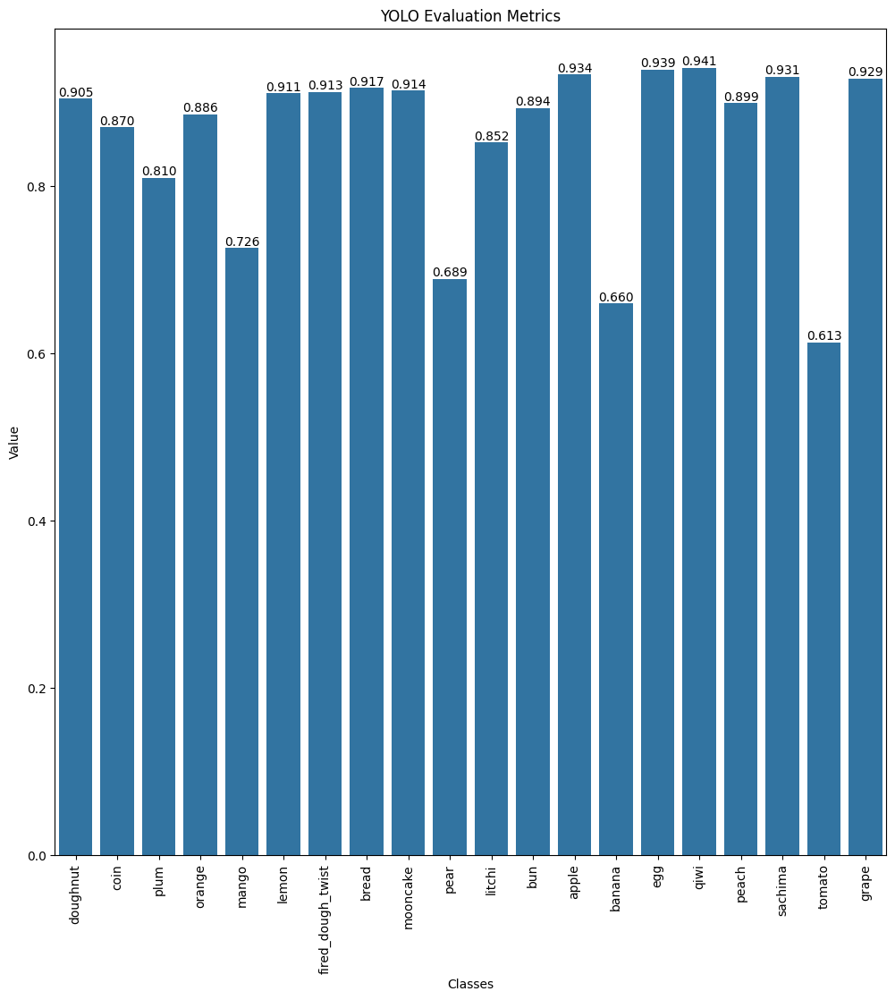

In [ ]:
classes = ['doughnut','coin','plum','orange','mango','lemon',
        'fired_dough_twist','bread','mooncake','pear',
        'litchi','bun','apple','banana','egg','qiwi',
        'peach','sachima','tomato','grape']

ax = sns.barplot(x=[cls for cls in classes], y=[map for map in metrics.box.maps],)

ax.set_title('YOLO Evaluation Metrics')
ax.set_xlabel('Classes')
ax.set_ylabel('Value')

fig = plt.gcf()
fig.set_size_inches(12, 12)

for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')

ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.show()


Now let's run validation on the test set only.

 We are using "val" because "predict" mode doesn't give any metrics. (somewhat similar like we did with Detectron2, where we used COCOEvaluator once for validation set and than again on test set, to get metrics).

  We will run "predict" mode after we see the "val" mode on the test set. Due to YOLO inability to use the test set path without modifications, we will first copy our data.yaml file, edit the path to the test set, and then run it.

  What we do is replace path to "val" with the path to "test".

In [ ]:
shutil.copyfile("/content/dataset_yolo/dataset.yaml","/content/dataset_yolo/dataset_test.yaml")
with open('/content/dataset_yolo/dataset_test.yaml', 'r') as f:
    data = yaml.safe_load(f)

data["val"] = "/content/dataset_yolo/test/images"

with open('/content/dataset_yolo/dataset_test.yaml', 'w') as f:
    yaml.dump(data, f, default_flow_style=False)
%cat /content/dataset_yolo/dataset_test.yaml

names:
- doughnut
- coin
- plum
- orange
- mango
- lemon
- fired_dough_twist
- bread
- mooncake
- pear
- litchi
- bun
- apple
- banana
- egg
- qiwi
- peach
- sachima
- tomato
- grape
nc: 20
path: ..
test: /content/dataset_yolo/test/images
train: /content/dataset_yolo/train/images
val: /content/dataset_yolo/test/images


In [ ]:
model = YOLO('/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt')  # load our custom model
metrics = model.val(data="/content/dataset_yolo/dataset_test.yaml",
                      project="/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results",
                      name="100_epochs-test",
                      save_json = True, conf = 0.5, plots = True)

Ultralytics YOLOv8.1.11 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 218 layers, 25851340 parameters, 0 gradients, 78.7 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 27.7MB/s]
val: Scanning /content/dataset_yolo/test/labels... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<00:00, 554.78it/s]

val: New cache created: /content/dataset_yolo/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [05:35<00:00, 25.82s/it]


                   all        200        410          1          1      0.995      0.933
              doughnut        200         10          1          1      0.995       0.97
                  coin        200        200          1          1      0.995      0.877
                  plum        200         10          1          1      0.995      0.931
                orange        200         12          1          1      0.995      0.995
                 mango        200         12          1          1      0.995      0.959
                 lemon        200         16          1          1      0.995      0.941
     fired_dough_twist        200         10          1          1      0.995      0.878
                 bread        200         10          1          1      0.995      0.912
              mooncake        200         10          1          1      0.995      0.915
                  pear        200         12          1          1      0.995      0.927
                litch

Let's see some curves and confusion metrices

In [ ]:
!ls /content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-test3

confusion_matrix_normalized.png  PR_curve.png		val_batch0_pred.jpg    val_batch2_pred.jpg
confusion_matrix.png		 predictions.json	val_batch1_labels.jpg
F1_curve.png			 R_curve.png		val_batch1_pred.jpg
P_curve.png			 val_batch0_labels.jpg	val_batch2_labels.jpg


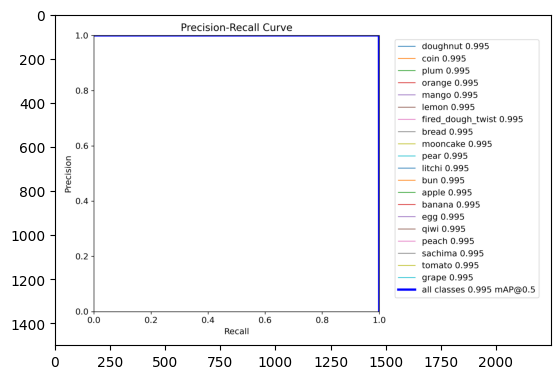

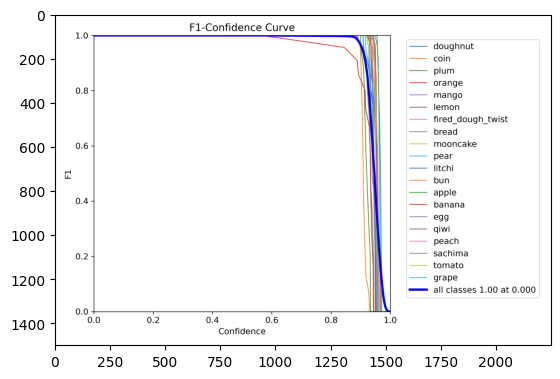

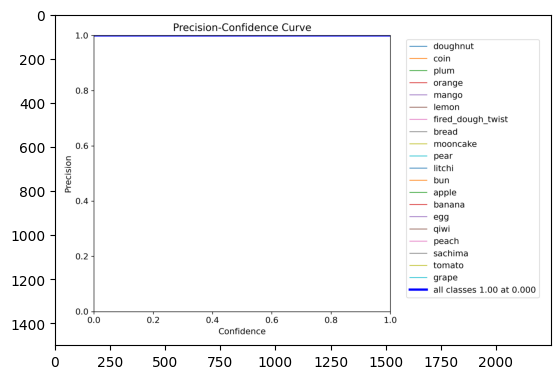

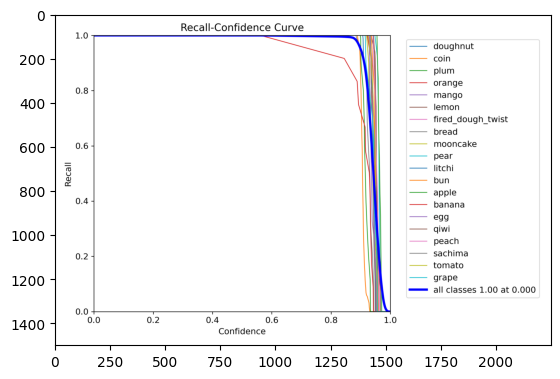

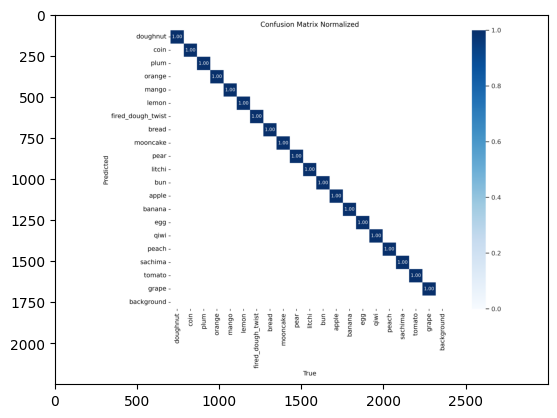

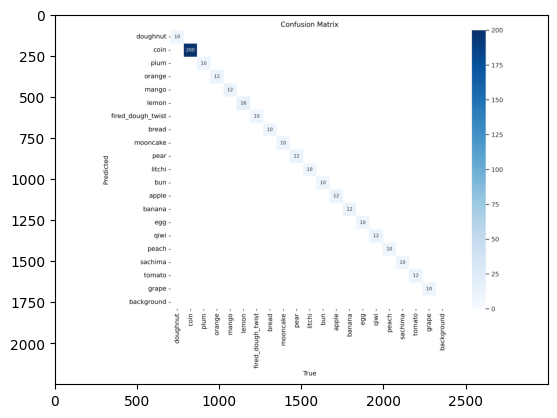

In [ ]:
import cv2
path = "/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-test3/"
for im in os.listdir(path):
  if im[-3:] == 'png':
    im = cv2.imread(path + im)
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    plt.imshow(im)
    plt.show()

The model is indeed doing great.

Now let's see mAP's for the test set, as we did for Detectron2:

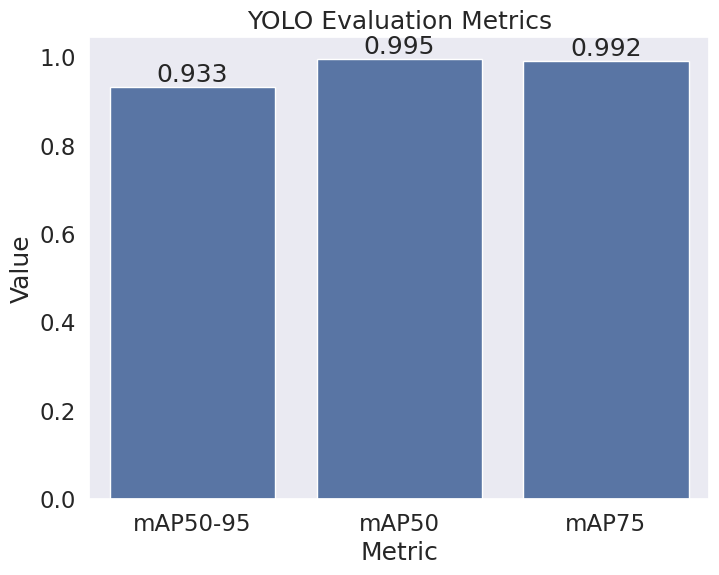

In [ ]:
ax = sns.barplot(x=['mAP50-95', 'mAP50', 'mAP75'], y=[metrics.box.map, metrics.box.map50, metrics.box.map75])

ax.set_title('YOLO Evaluation Metrics')
ax.set_xlabel('Metric')
ax.set_ylabel('Value')

fig = plt.gcf()
fig.set_size_inches(8, 6)

for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')

plt.show()

<ipython-input-25-d6f4eea00a51>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


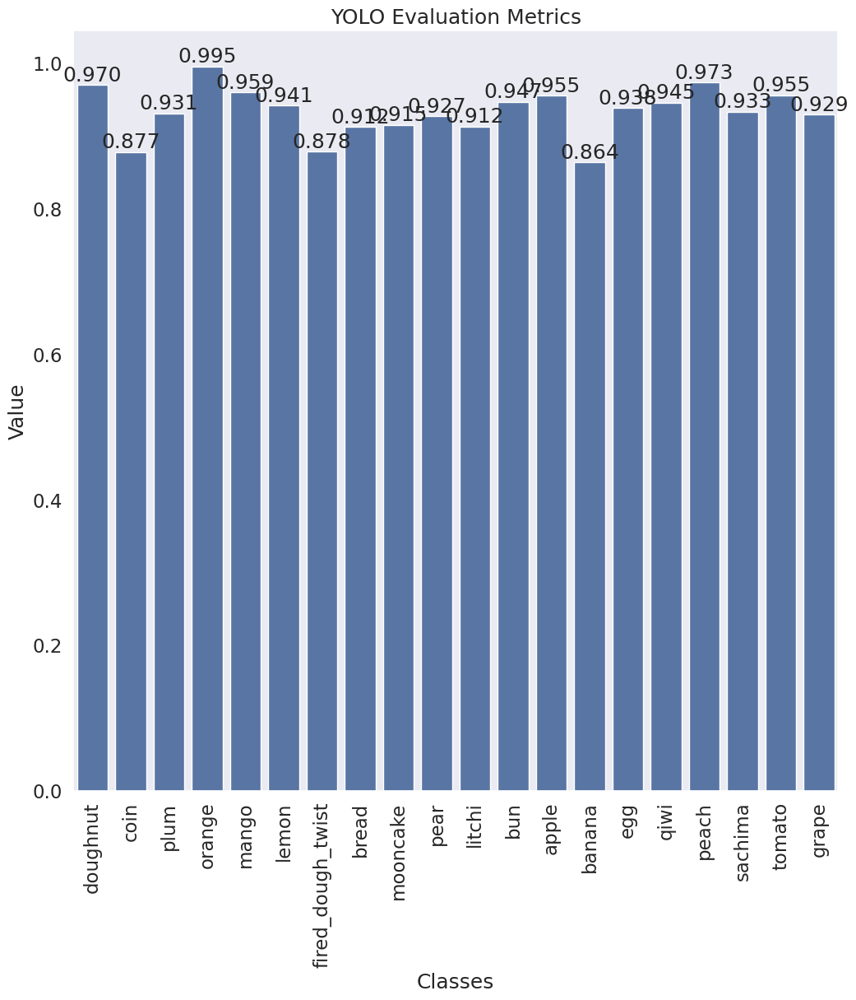

In [ ]:
classes = ['doughnut','coin','plum','orange','mango','lemon',
        'fired_dough_twist','bread','mooncake','pear',
        'litchi','bun','apple','banana','egg','qiwi',
        'peach','sachima','tomato','grape']

ax = sns.barplot(x=[cls for cls in classes], y=[map for map in metrics.box.maps],)

ax.set_title('YOLO Evaluation Metrics')
ax.set_xlabel('Classes')
ax.set_ylabel('Value')

fig = plt.gcf()
fig.set_size_inches(12, 12)

for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')

ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.show()

It's time to see how it does on the test set, we predit and save our results to a csv file for later:

In [ ]:
import csv
import datetime
start = datetime.datetime.now()

input_images_directory = "/content/drive/MyDrive/dataset_yolo/test/images/"

output_directory = "/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-test/"
if not os.path.exists(output_directory):
  os.mkdir(output_directory)

name = "test_prediction_images"
output_csv_path = output_directory +  "/output_objects_yolo.csv"

with open(output_csv_path, 'w', newline='') as csvfile:

    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(["image","image_with_preds","og_class", "pred_class", "pred_bbox"])

    trained_model = YOLO('/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-/weights/best.pt')

    results=(trained_model.predict(source = input_images_directory,
                                          project=output_directory,
                                          name= name,
                                          save=True,
                                          imgsz=640,
                                          conf=0.5))

    for res in results:
        new_result = res
        detected_boxes = new_result.boxes.data
        class_labels = detected_boxes[:, -1].int().tolist()
        class_name = []
        og_class = []
        og_class_name = []
        path = "/content/drive/MyDrive/dataset_yolo/test/labels" + res.path.split("/images")[1][:-3]+"txt"
        with open(path,"r") as f:
          data = f.readlines()
        for i in range(len(data)):
          og_class.append(int(data[i][:2]))
        class_names = list(new_result.names.values())
        for i in range(len(detected_boxes)):
            if i < len(class_labels):
                class_label = class_labels[i]
                class_name.append(class_names[class_label])
        for i in range(len(og_class)):
            class_l = og_class[i]
            og_class_name.append(class_names[class_l])
        result_filename = res.path.split("/")[-1] + "-YOLOv8-result.JPG"
        output_path = output_directory + name + "/" + result_filename
        csvwriter.writerow([res.path,output_path, og_class_name, class_name, detected_boxes])

print("Test images completed.")
end = datetime.datetime.now()
print("Total execution time with of prediction with YOLOv8 is: ", end-start)



image 1/200 /content/drive/MyDrive/dataset_yolo/test/images/apple010S(1).JPG: 480x640 1 coin, 1 apple, 1344.2ms
image 2/200 /content/drive/MyDrive/dataset_yolo/test/images/apple010T(1).JPG: 480x640 1 coin, 1 apple, 1179.0ms
image 3/200 /content/drive/MyDrive/dataset_yolo/test/images/apple014S(6).JPG: 480x640 1 coin, 1 apple, 1410.2ms
image 4/200 /content/drive/MyDrive/dataset_yolo/test/images/apple014T(6).JPG: 480x640 1 coin, 1 apple, 1157.5ms
image 5/200 /content/drive/MyDrive/dataset_yolo/test/images/apple016S(12).JPG: 480x640 1 coin, 1 apple, 1142.4ms
image 6/200 /content/drive/MyDrive/dataset_yolo/test/images/apple016T(12).JPG: 480x640 1 coin, 1 apple, 1142.0ms
image 7/200 /content/drive/MyDrive/dataset_yolo/test/images/apple017S(26).JPG: 480x640 1 coin, 1 apple, 1163.2ms
image 8/200 /content/drive/MyDrive/dataset_yolo/test/images/apple017T(26).JPG: 480x640 1 coin, 1 apple, 1430.7ms
image 9/200 /content/drive/MyDrive/dataset_yolo/test/images/apple018S(2).JPG: 480x640 1 coin, 1 app

In [ ]:
path = "/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-test/test_prediction_images/"
for im in os.listdir(path):
  os.rename(path + im,path + im + "-YOLOv8-result.JPG")

Now let's see some predictions:

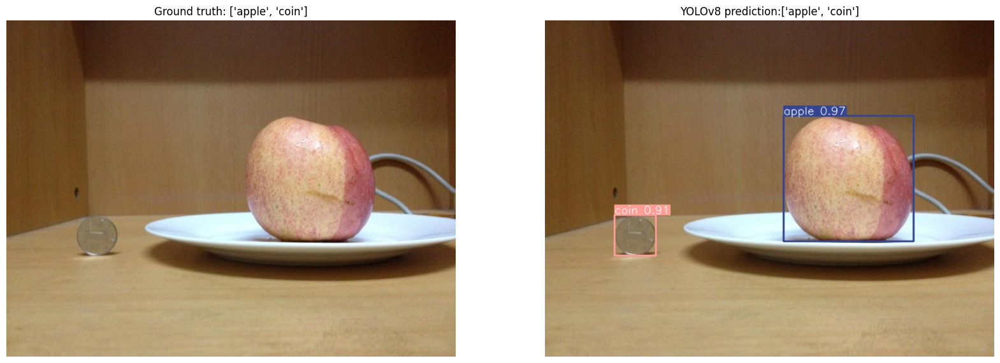

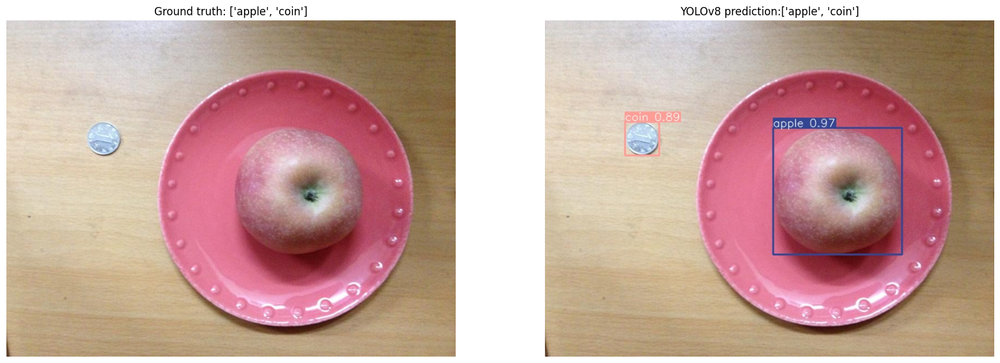

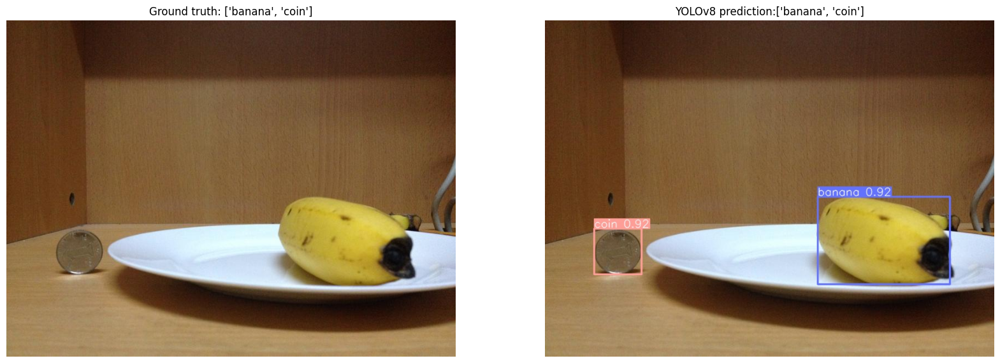

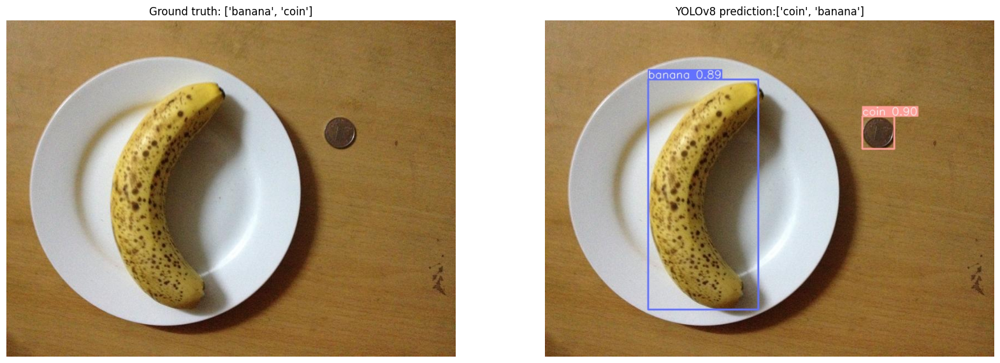

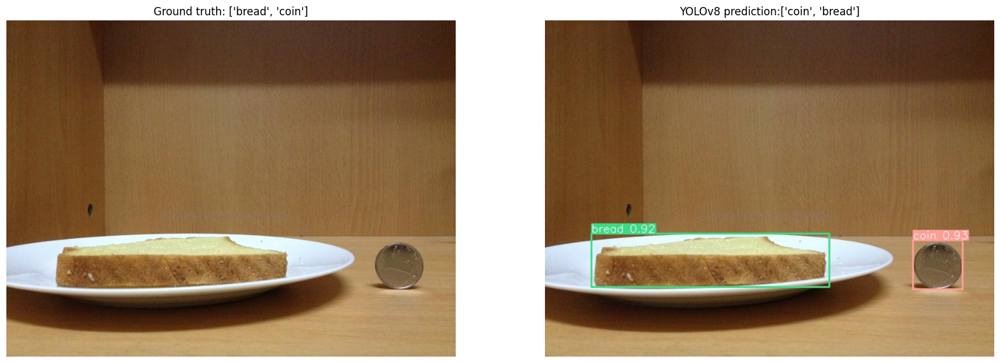

...

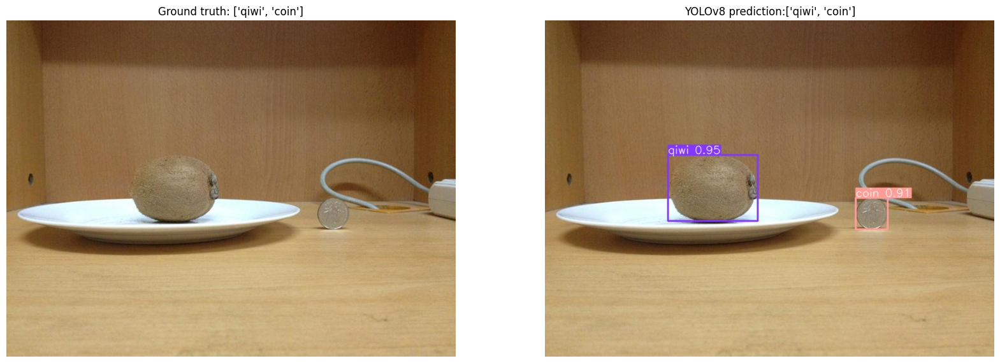

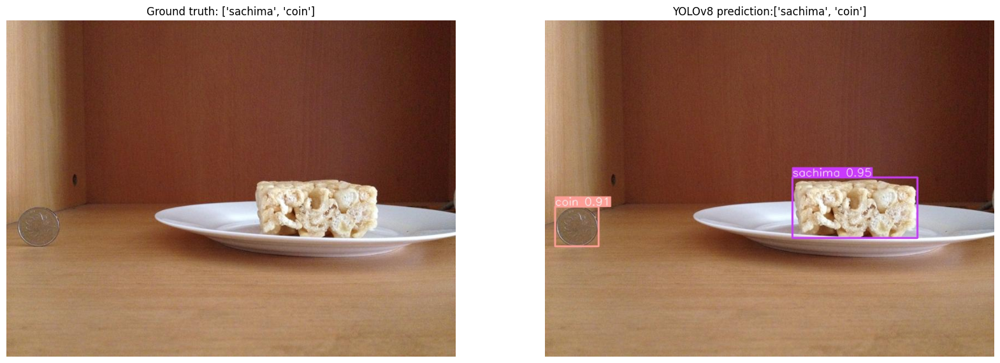

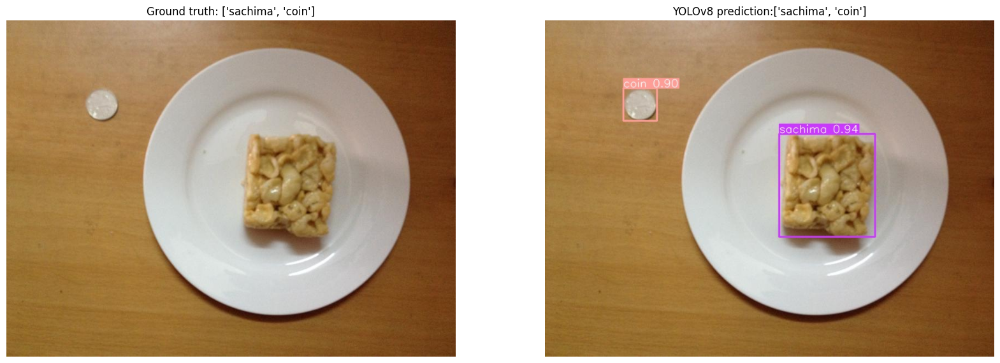

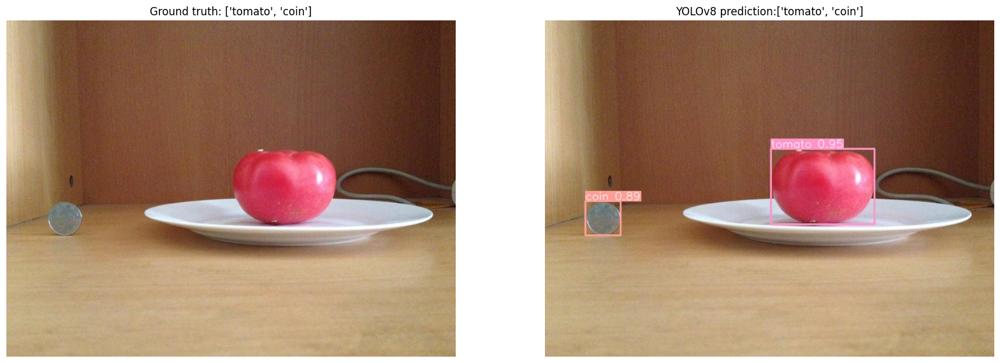

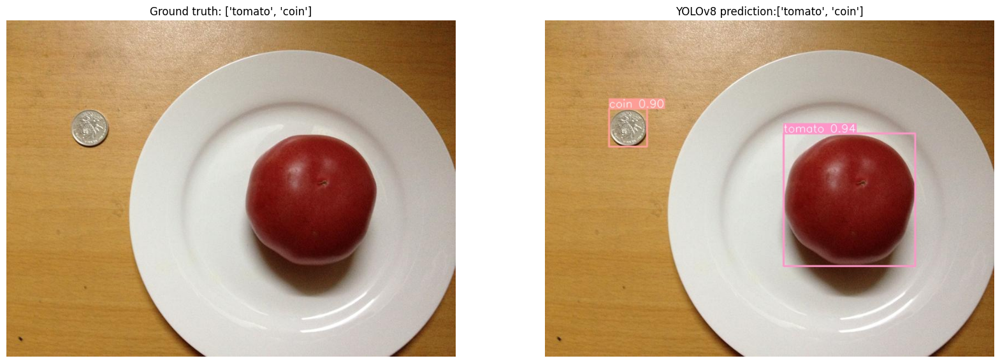

In [ ]:
df_yolo = pd.read_csv("/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-test/output_objects_yolo.csv")
for i in range(len(df_yolo["image_with_preds"])):    #select number of images for display
    if i%5 == 0:
      fig, axes = plt.subplots(figsize=(20,20), ncols=2, nrows=1)
      image = cv2.imread(df_yolo["image"][i])
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      label = df_yolo["og_class"][i]
      axes[0].imshow(image)
      axes[0].title.set_text('Ground truth: ' + label)
      axes[0].axis('off')
      image = cv2.imread(df_yolo["image_with_preds"][i])
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      label = df_yolo["pred_class"][i]
      axes[1].imshow(image)
      axes[1].title.set_text('YOLOv8 prediction:' + label)
      axes[1].axis('off')
      plt.show()

Let's see any mislabeled predictions:

['peach', 'coin'] ['coin', 'peach', 'lemon']
/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-test/test_prediction_images/peach001T(9).JPG-YOLOv8-result.JPG


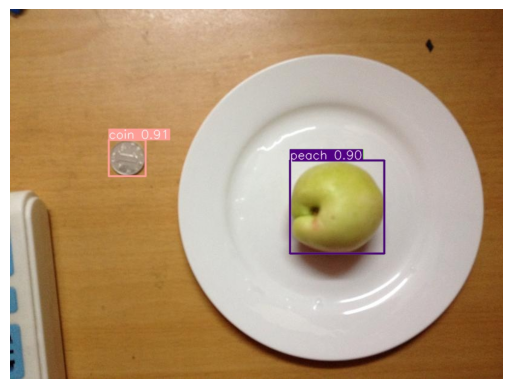

Number of mislabeld images is: 1


In [ ]:
count = 0
for index, row in df_yolo.iterrows():
  if sorted(df_yolo["og_class"][index]) != sorted(df_yolo["pred_class"][index]):
    count += 1
    print(df_yolo["og_class"][index],df_yolo["pred_class"][index])
    print(df_yolo["image_with_preds"][index])
    image = cv2.imread(df_yolo["image_with_preds"][index])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image)
    plt.axis("off")
    plt.show()
print("Number of mislabeld images is:", count)

Awesome! only one mislabeled image, and also a false positive. Looks like YOLO is doing a great job too!
Now let's take a look on all of our models and try to compare the results.